# Customer Churn Detection
<div style="text-align: center;">
<img src="imgs/customer-churn.jpg" width="800" height="600" align="center"/> 
</div>
Customer churn refers to when customers stop using a company’s products or services. It's crucial for businesses to detect churn early because acquiring new customers is often more expensive than retaining existing ones. High churn rates can signal dissatisfaction, poor service, or better competitor offerings. By identifying at-risk customers through behavior analysis, feedback, or usage patterns, companies can take proactive steps—like personalized offers or support—to improve satisfaction and loyalty. Reducing churn boosts revenue, strengthens brand reputation, and enhances long-term growth. Ultimately, understanding and managing churn helps ensure a stable, loyal customer base and healthier business performance. 

In this project you will be a data scientist in charge to detect the company's worst nightmare, the customer churn and prevent from them before they go.

# Data import

In [1]:
!pip install -q -r requirements.txt

In [2]:
!pip show pandas-profiling

Name: pandas-profiling
Version: 3.6.6
Summary: Deprecated 'pandas-profiling' package, use 'ydata-profiling' instead
Home-page: https://github.com/ydataai/pandas-profiling
Author: YData Labs Inc
Author-email: opensource@ydata.ai
License: MIT
Location: c:\users\denys\anaconda3\envs\restapi\lib\site-packages
Requires: ydata-profiling
Required-by: 


In [39]:
import pandas as pd 
import numpy as np
from sklearn.model_selection import train_test_split
from matplotlib import pyplot as plt
from ydata_profiling import ProfileReport
import seaborn as sns 

We first read the data file and inspect what kind of columns and data are here, after you read the dataset you will see the first five rows and will note several numerical and categorical variables.  At the end there will be a column called **churn**, that's our objective/target variable.

A general description of the columns is described below.

Here’s a description of each column in the dataset:
- id: Unique identifier for each customer.
- state_code: Abbreviation of the customer's state.
- tenure: Number of months the customer has been with the company.
- contract_length: Duration of the customer’s contract in months.
- promotions_offered: Indicates if the customer received any promotions.
- remaining_term: Months left in the customer's contract.
- last_nps_rating: Most recent Net Promoter Score rating given by the customer.
- area_code: Geographic telephone area code.
- international_plan: Whether the customer has an international call plan.
- voice_mail_plan: Whether the customer has a voicemail plan.
- total_eve_calls: Number of evening calls made by the customer.
- total_eve_charge: Total charges for evening calls.
- total_night_minutes: Total minutes used at night.
- total_night_calls: Number of calls made at night.
- total_night_charge: Total charges for night calls.
- total_intl_minutes: Total international call minutes used.
- total_intl_calls: Number of international calls made.
- total_intl_charge: Total charges for international calls.
- number_customer_service_calls: Times the customer contacted customer service.
- churn: Whether the customer has left the service (“yes” or “no”).

In [20]:
df = pd.read_csv('classificationdata.csv', index_col='id')

In [21]:
df.head()

,state_code,tenure,contract_length,promotions_offered,remaining_term,last_nps_rating,area_code,international_plan,voice_mail_plan,number_vmail_messages,...,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls,churn
id,,,,,,,,,,,,,,,,,,,,,
0,HI,156,14.0,Yes,1.0,6.0,area_code_510,no,no,0,...,108,19.138302,208.349932,130,9.190181,8.015688,7,2.248902,7,no
1,MI,216,8.0,No,14.0,9.0,area_code_408,no,no,3,...,71,15.474436,228.902063,85,10.277852,9.683971,8,2.609739,3,no
2,NH,18,20.0,No,12.0,1.0,area_code_408,no,no,1,...,55,22.547297,202.353527,127,8.898488,14.039450,8,3.845776,2,no
3,MN,174,9.0,No,12.0,6.0,area_code_415,no,no,2,...,105,16.666506,214.487530,105,9.740333,13.031063,4,3.525823,1,no
4,TX,68,19.0,No,22.0,5.0,area_code_415,no,no,1,...,88,20.408969,190.047534,113,8.813303,6.760950,4,1.828652,0,no


We also want to see the last 5 rows.

In [22]:
df.tail()

,state_code,tenure,contract_length,promotions_offered,remaining_term,last_nps_rating,area_code,international_plan,voice_mail_plan,number_vmail_messages,...,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls,churn
id,,,,,,,,,,,,,,,,,,,,,
17238,NY,142,14.0,No,1.0,1.0,area_code_415,yes,no,2,...,125,14.191124,62.263008,89,2.872740,0.493638,0,0.250048,3,yes
17239,ID,93,8.0,No,9.0,7.0,area_code_415,yes,yes,29,...,134,23.784585,224.625284,95,10.627770,12.870274,6,3.370551,1,no
17240,TX,110,24.0,No,3.0,7.0,area_code_510,no,no,2,...,123,21.482982,146.474026,59,6.367553,14.037650,5,4.001911,4,no
17241,TN,8,10.0,No,3.0,10.0,area_code_415,no,no,1,...,83,24.633320,214.348043,88,9.179660,7.373555,2,1.921722,1,no
17242,VA,61,18.0,No,10.0,10.0,area_code_408,no,no,1,...,78,12.918930,203.770825,85,8.975769,7.166460,4,1.947350,0,no


# Database splitting

<div style="text-align: center;">
<img src="imgs/training-validation-test-data-set.png" width="480" height="600" align="center"/> 
</div>

Now for preventing data bias, we will shuffle the dataset and also giving some variability and stratification.  

We also want as much variance in the datasets but not mixing the training data with the test data.  Let's first do the first part, divide in 80/20 the training set shuffling the data and preserving the stratification.

In [23]:
np.random.seed(42) # for preserving the same results accross the notebook

In [24]:
df['churn'].fillna('no', inplace=True) # because the target has NaN values (not a number), let's assume that are default zeroes
train, test = train_test_split(df, test_size=0.2, shuffle=True, random_state=42)

C:\Users\Denys\AppData\Local\Temp\ipykernel_14152\3688168874.py:1: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df['churn'].fillna('no', inplace=True) # because the target has NaN values (not a number), let's assume that are default zeroes


Let's now separate the training set into the training and validation.

- The training set will be the dataset used to train the model
- The validation set is part of the training set that we will use for see the model's performance in training
- The test set is the part of the datast that is not seen by the training but will be the real samples to see if the model generalizes

One thing to note is the value *test_size*, it is the portion of data that will be used on the tests and also the *random_state* that ensures everytime that we run the cell we will have the same split of the data.

In [25]:
X_temp = train.drop('churn', axis=1) # drop the churn colum
y_temp = train['churn'] # get the churn variable (the binary target)

In [26]:
X_train, X_test, y_train, y_test = train_test_split(X_temp, y_temp, test_size=0.2, random_state=42, stratify=y_temp)

Now let's see something interesting, let's view what does stratify does with the target

In [27]:
y_train.value_counts()

churn
no     9453
yes    1582
Name: count, dtype: int64

In [28]:
y_test.value_counts()

churn
no     2364
yes     395
Name: count, dtype: int64

This view doesn't makes sense, let's view the proportions using normalize

In [29]:
y_train.value_counts(normalize=True)

churn
no     0.856638
yes    0.143362
Name: proportion, dtype: float64

In [30]:
y_test.value_counts(normalize=True)

churn
no     0.856832
yes    0.143168
Name: proportion, dtype: float64

Now this has more sense.  What stratify does is that divide the population in similar parts from the holdout / validation set and the training set.

# 3. EDA (Exploratory Data Analysis)

<div style="text-align: center;">
<img src="imgs/1703364386900.jpg" width="480" height="600" align="center"/> 
</div>

Exploratory Data Analysis (EDA) is the process of examining and visualizing datasets to understand their main characteristics before modeling. It helps uncover patterns, detect anomalies, test assumptions, and check data quality. Typical EDA tasks include:

- Summarizing statistics (mean, median, std, etc.)
- Visualizing distributions (histograms, boxplots)
- Analyzing relationships (scatter plots, correlation heatmaps)
- Handling missing or inconsistent data
- Identifying outliers or skewness

EDA is a critical first step in any data science workflow—it guides feature engineering, model selection, and improves overall decision-making.

## Data Exploration

Now we will see some insights of the data, at first we will see the basic information of the dataframe:
- it tells use the number of features
- the column names
- the total entries and if they are not-null
- the type of object

We have to determine what we will do with these null values but let's worry about later.

In [31]:
train.info()

<class 'pandas.core.frame.DataFrame'>
Index: 13794 entries, 4115 to 15795
Data columns (total 24 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   state_code                     13794 non-null  object 
 1   tenure                         13794 non-null  int64  
 2   contract_length                13755 non-null  float64
 3   promotions_offered             13755 non-null  object 
 4   remaining_term                 13755 non-null  float64
 5   last_nps_rating                13755 non-null  float64
 6   area_code                      13783 non-null  object 
 7   international_plan             13794 non-null  object 
 8   voice_mail_plan                13765 non-null  object 
 9   number_vmail_messages          13794 non-null  int64  
 10  total_day_minutes              13794 non-null  float64
 11  total_day_calls                13794 non-null  int64  
 12  total_day_charge               13794 non-null  f

In [32]:
train.isnull().sum() # check the nulls values present

state_code                        0
tenure                            0
contract_length                  39
promotions_offered               39
remaining_term                   39
last_nps_rating                  39
area_code                        11
international_plan                0
voice_mail_plan                  29
number_vmail_messages             0
total_day_minutes                 0
total_day_calls                   0
total_day_charge                  0
total_eve_minutes                17
total_eve_calls                   0
total_eve_charge                  0
total_night_minutes               0
total_night_calls                 0
total_night_charge                0
total_intl_minutes                0
total_intl_calls                  0
total_intl_charge                 0
number_customer_service_calls     0
churn                             0
dtype: int64

Below we will see that we describe statistically the dataset
A thing to know is that the percentiles describe the population in similar parts, but read more on what they do to clarify.
- The median is called the 50 percentile or the 2nd quartile
- The 25 percentile is called the 1st quartile
- The 75 percentile is called the 3rt quartile
This is properly important on whisker plots that we will see later

In [33]:
train.describe(percentiles=(0.25, 0.5, 0.75, 0.9, 0.95)) # statistical description of the train dataset

,tenure,contract_length,remaining_term,last_nps_rating,number_vmail_messages,total_day_minutes,total_day_calls,total_day_charge,total_eve_minutes,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls
count,13794.000000,13755.000000,13755.000000,13755.000000,13794.000000,13794.000000,13794.000000,13794.000000,13777.000000,13794.00000,13794.000000,13794.000000,13794.000000,13794.000000,13794.000000,13794.000000,13794.000000,13794.000000
mean,100.150935,15.911668,11.134642,6.105416,8.641293,180.387681,100.135566,30.669582,200.355776,100.31115,17.028550,199.626354,100.017254,8.982633,10.301534,4.942366,2.774668,1.552414
std,39.739927,4.883994,7.211600,2.726455,13.035855,54.387496,20.053699,9.254292,50.798903,19.90521,4.317780,51.130423,20.370166,2.297606,2.774209,2.507080,0.741838,1.315480
min,1.000000,8.000000,1.000000,1.000000,0.000000,0.005090,1.000000,0.027050,5.367495,1.00000,1.082034,3.896507,4.000000,0.500865,0.032252,0.000000,0.013478,0.000000
25%,72.000000,12.000000,5.000000,4.000000,1.000000,143.371825,87.000000,24.424805,166.897648,87.00000,14.155799,165.217013,86.000000,7.442417,8.537325,3.000000,2.302714,1.000000
50%,100.000000,16.000000,10.000000,7.000000,2.000000,180.183814,100.000000,30.612589,200.905248,101.00000,17.064639,198.672681,100.000000,8.948534,10.375841,5.000000,2.809933,1.000000
75%,127.000000,20.000000,18.000000,8.000000,16.000000,217.693930,113.000000,36.964816,234.285354,114.00000,19.900518,234.484643,114.000000,10.538363,12.072012,6.000000,3.258496,2.000000
90%,151.000000,23.000000,22.000000,9.000000,31.000000,249.364908,126.000000,42.417245,265.653731,125.00000,22.590104,265.627385,126.000000,11.970065,13.746988,8.000000,3.679635,3.000000
95%,167.000000,24.000000,23.000000,10.000000,37.000000,272.035065,133.000000,46.209261,283.031379,133.00000,24.053479,283.477242,132.000000,12.770110,14.753337,10.000000,3.935508,4.000000
max,242.000000,24.000000,24.000000,10.000000,52.000000,351.091823,165.000000,59.727092,357.643745,169.00000,30.515222,394.851052,173.000000,17.700351,19.981388,20.000000,5.360148,9.000000


In [34]:
train.describe(include='object') # list only object values

,state_code,promotions_offered,area_code,international_plan,voice_mail_plan,churn
count,13794,13755,13783,13794,13765,13794
unique,51,3,3,2,2,2
top,WV,No,area_code_415,no,no,no
freq,450,12512,6819,12481,10160,11817


 Now is time to inspect using a univariate analysis.

 A univariate analysis is an analysis variable per variable, without taking in consideration any relationship, we will see some hypotesis to formulate and later validate.

What we can do there is the visual inspection and make some hypothesis, lets focus on the last_nps_rating.
We see that we have a lot of good reviews (reviews above 6 is normal and are the majority), but we can have also bad reviews that are homogeneous (1,2,3,4)... we do not receive the neutral valuation (5) so much.  We can say that the service is nearly ok but we have a lot of possible churners.

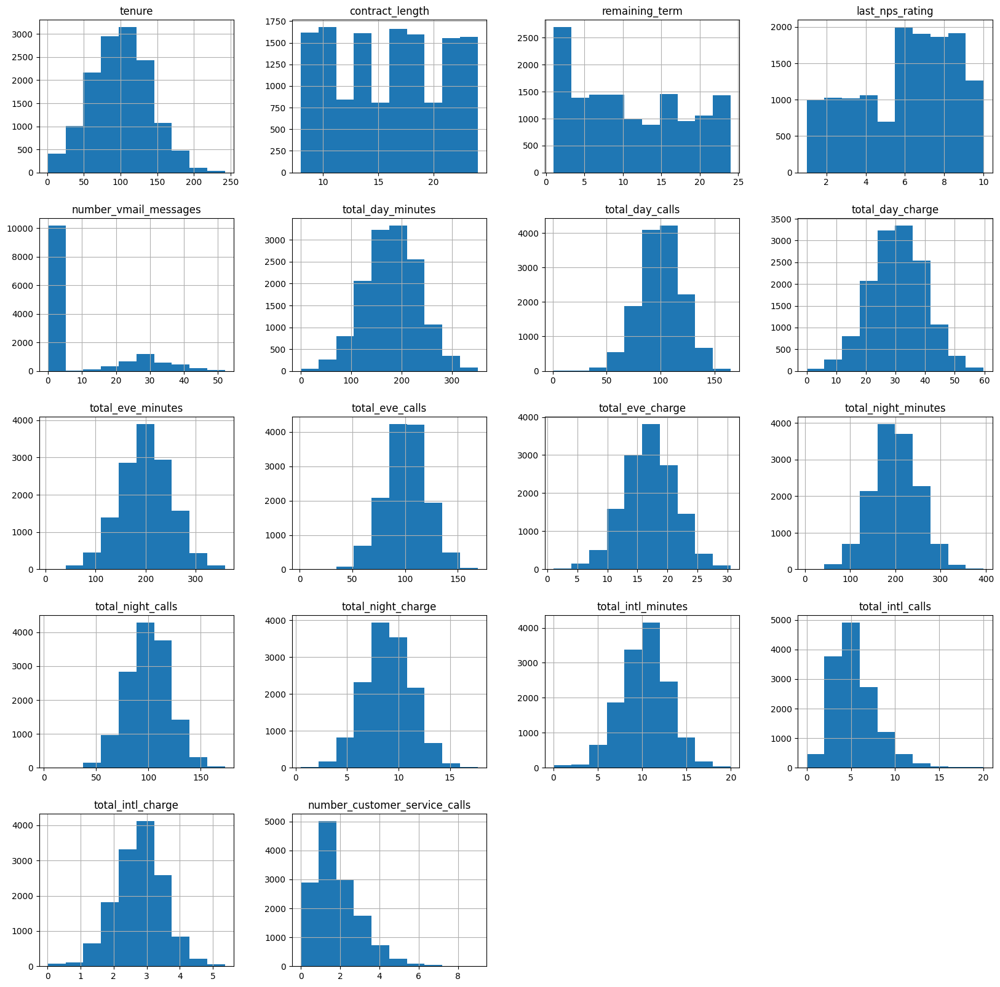

In [35]:
train.hist(figsize=(20,20))
plt.show()

## Using pandas profiling for fast EDA

Pandas profiling is a good way to check the dataset, but it works well for small datasets, for huge BIG DATA sets, is better to use some analysis tools like PySpark that allows efficient data handling or Polars, the equivalent of pandas for fast EDA.

In [36]:
profile = ProfileReport(train, title='Pandas Profiling Report')

In [37]:
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 24/24 [00:00<00:00, 41.11it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## Categorical Data Analysis

Now that we analyzed basically the numerical data by univariate analysis, let's continue with the target.

The churn taget is categorical, that is, is not numerical, so we need a countplot to visualize it.

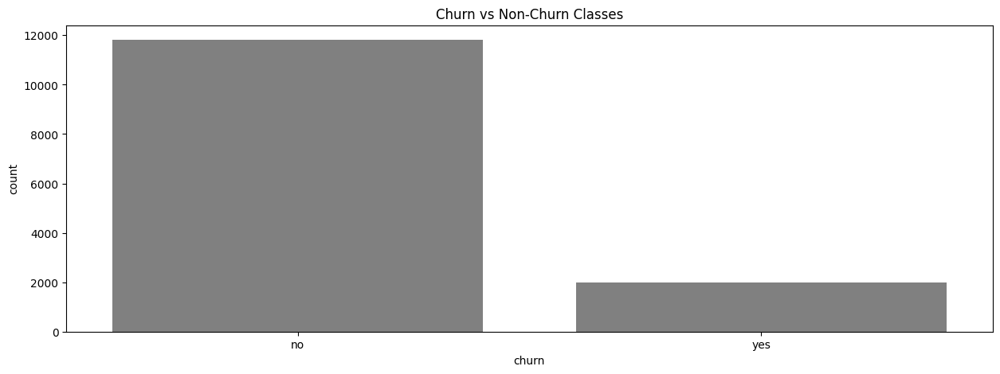

In [41]:
plt.figure(figsize=(15,5))
sns.countplot(x='churn', data=train, color='gray').set_title('Churn vs Non-Churn Classes')
plt.show()

There are other categorical variables that we can inspect, that are state_code, promotions_offered and area_code

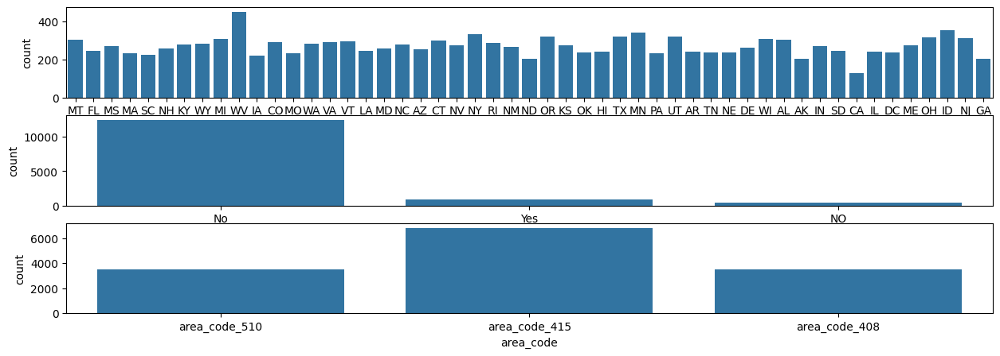

In [42]:
# Plotting out multiple plots in the same canvas
fig, axs = plt.subplots(3, figsize=(15,5))
sns.countplot(data=train, x='state_code', ax=axs[0])
sns.countplot(data=train, x='promotions_offered', ax=axs[1])
sns.countplot(data=train, x='area_code', ax=axs[2])
plt.show()

We can also save the plot to the disc for future reporting and presentation to communicate with the stakeholders.

In [43]:
# Save plot to disc
fig.get_figure().savefig('outputplot.png')

## Numerical Feature Analysis

Let's see the proportions of some data

In [44]:
train.dtypes

state_code                        object
tenure                             int64
contract_length                  float64
promotions_offered                object
remaining_term                   float64
last_nps_rating                  float64
area_code                         object
international_plan                object
voice_mail_plan                   object
number_vmail_messages              int64
total_day_minutes                float64
total_day_calls                    int64
total_day_charge                 float64
total_eve_minutes                float64
total_eve_calls                    int64
total_eve_charge                 float64
total_night_minutes              float64
total_night_calls                  int64
total_night_charge               float64
total_intl_minutes               float64
total_intl_calls                   int64
total_intl_charge                float64
number_customer_service_calls      int64
churn                             object
dtype: object

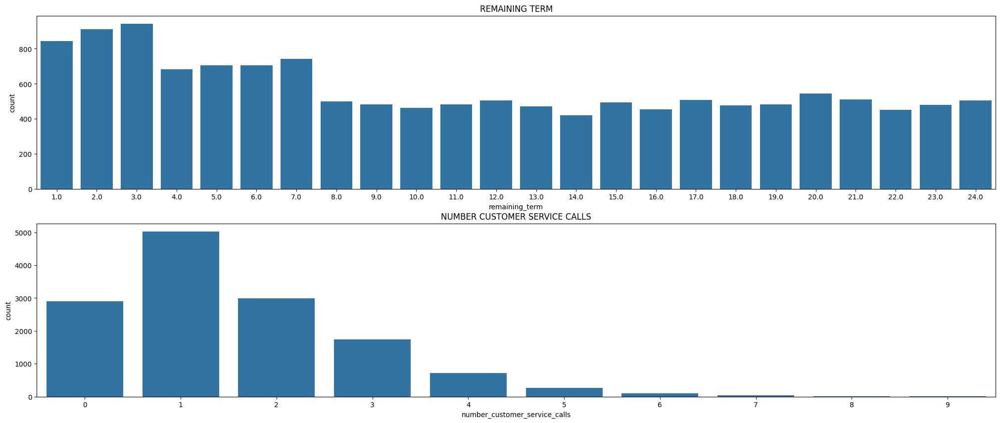

In [51]:
# Viz on vmail messages and customer service calls
fig, axs = plt.subplots(2, figsize=(25,10))
sns.countplot(x='remaining_term', data=train, ax=axs[0]).set_title('REMAINING TERM')
sns.countplot(x='number_customer_service_calls', data=train, ax=axs[1]).set_title('NUMBER CUSTOMER SERVICE CALLS')
plt.show()

We can see here that the number of remaining terms are probably below 10, that is the effort of calls is between these ocurrencies and the number of customer service calls are usually 1, that respects the probable showcase of calls per customers, we usually do not see too much calls over 5 to the customers so it will be probably not too much information for that cases.

Another thing to note here is the skewness, that is probably over 0 because we have a long right tail.  Remember, the models need to be trained with normally distributed data because they where coniceived in that way.

In [52]:
fig.get_figure().savefig('newplot.png')

### Skewness of some columns


<div style="text-align: center;">
<img src="imgs/1689255917940.png" width="480" height="600" align="center"/> 
</div>



positive means a long right tail

In [59]:
train['number_customer_service_calls'].skew()

np.float64(1.0837895298285183)

In [57]:
train['log_customer_service_calls'] = np.log(train['number_customer_service_calls']+1) # for make it normally distributed

now see the skewness is practically gone, what we did is part of the feature engineering

In [58]:
train['log_customer_service_calls'].skew() 

np.float64(-0.11699734561300201)

Let's see the final plot together and note that the right is better distributed than the left.

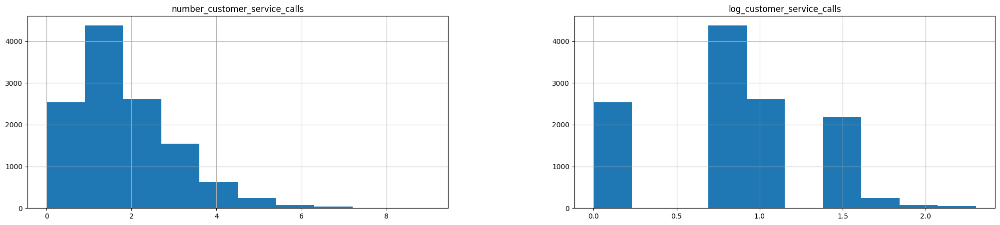

In [32]:
train[['number_customer_service_calls','log_customer_service_calls']].hist(figsize=(25,5))
plt.show()

In [61]:
# we will drop the log of the customers because even if there is well distributed, there are some hows in the data (my criterion)
train = train.drop('log_customer_service_calls', axis=1)

In [62]:
train.dtypes

state_code                        object
tenure                             int64
contract_length                  float64
promotions_offered                object
remaining_term                   float64
last_nps_rating                  float64
area_code                         object
international_plan                object
voice_mail_plan                   object
number_vmail_messages              int64
total_day_minutes                float64
total_day_calls                    int64
total_day_charge                 float64
total_eve_minutes                float64
total_eve_calls                    int64
total_eve_charge                 float64
total_night_minutes              float64
total_night_calls                  int64
total_night_charge               float64
total_intl_minutes               float64
total_intl_calls                   int64
total_intl_charge                float64
number_customer_service_calls      int64
churn                             object
dtype: object

## Bivariate Analysis

### Numeric Correlation

The numeric correlation of the data says how much is related one variable with another.  The heatmat can show us this relationships in the plot.

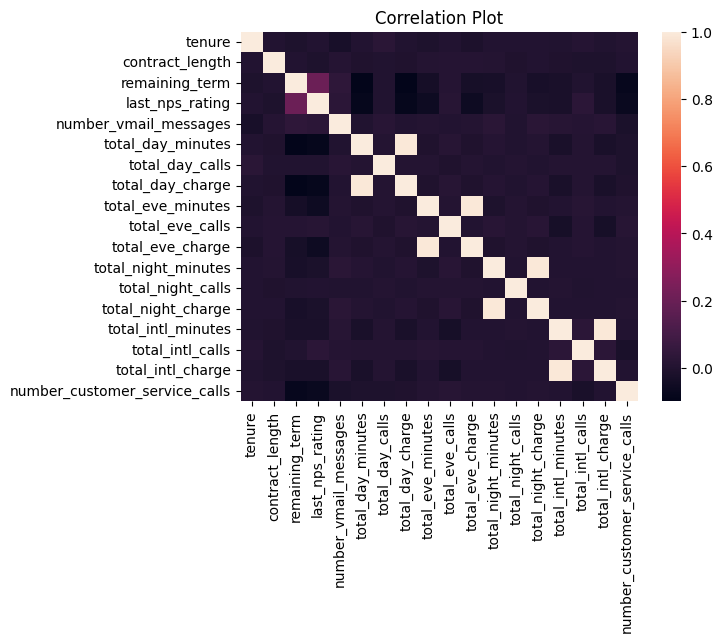

In [63]:
sns.heatmap(train.select_dtypes(exclude='object').corr()).set_title('Correlation Plot')
plt.show()

In [64]:
train.dtypes

state_code                        object
tenure                             int64
contract_length                  float64
promotions_offered                object
remaining_term                   float64
last_nps_rating                  float64
area_code                         object
international_plan                object
voice_mail_plan                   object
number_vmail_messages              int64
total_day_minutes                float64
total_day_calls                    int64
total_day_charge                 float64
total_eve_minutes                float64
total_eve_calls                    int64
total_eve_charge                 float64
total_night_minutes              float64
total_night_calls                  int64
total_night_charge               float64
total_intl_minutes               float64
total_intl_calls                   int64
total_intl_charge                float64
number_customer_service_calls      int64
churn                             object
dtype: object

In the above graph was not included the churn variable becaus is an categorical one, let's crate the heatmap to view the relationship of all variables with respect to the churn variable, but first we will transform these to a numeric one.

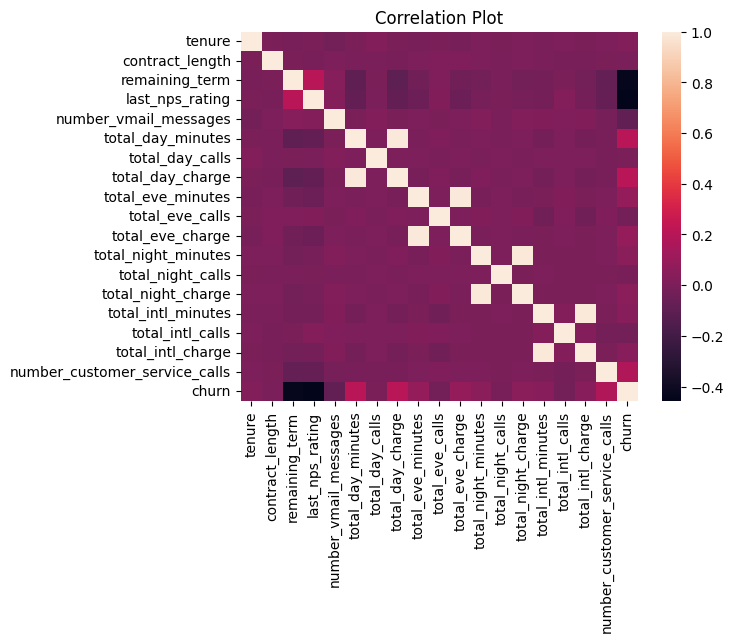

In [66]:
temp = train.copy()
temp['churn'] = temp['churn'].apply(lambda x: 1 if x=='yes' else 0) 
sns.heatmap(temp.select_dtypes(exclude='object').corr()).set_title('Correlation Plot')
plt.show()

### Violin Plots

A violin plot is a data visualization that shows the distribution of a numeric variable across different categories. It combines a box plot and a kernel density plot:

- The width of the "violin" shows the probability density (how often values occur).
- The center shows the median and interquartile range like a box plot.

Violin plots are useful for comparing distributions between groups, especially when the data is not normally distributed or has multiple peaks.

Exploring the data below Churn vs variables, there is a proper linear relationshib between this two variables.

See the Churn vs remaining_term, there is a proper churn probability to ocurr below 2 that is more notable to ocurr

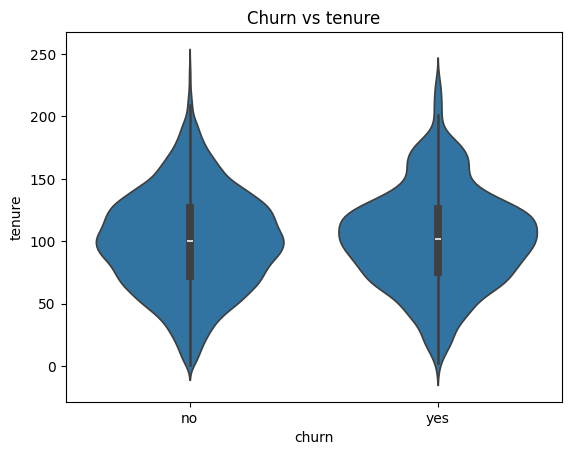

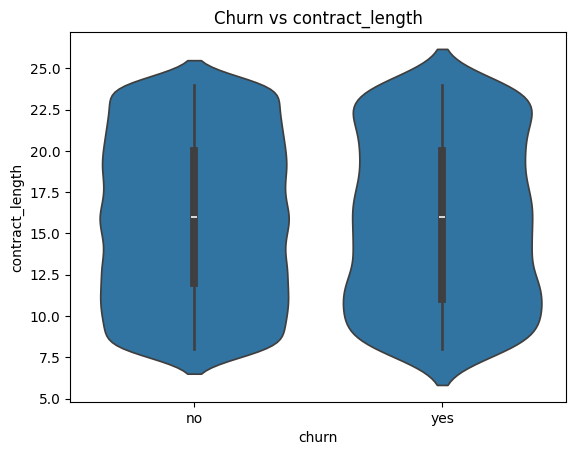

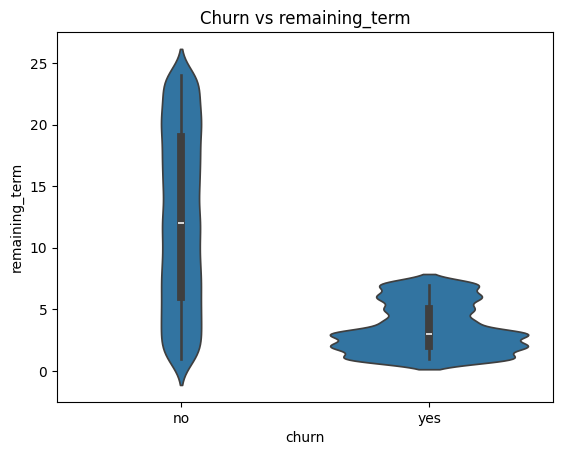

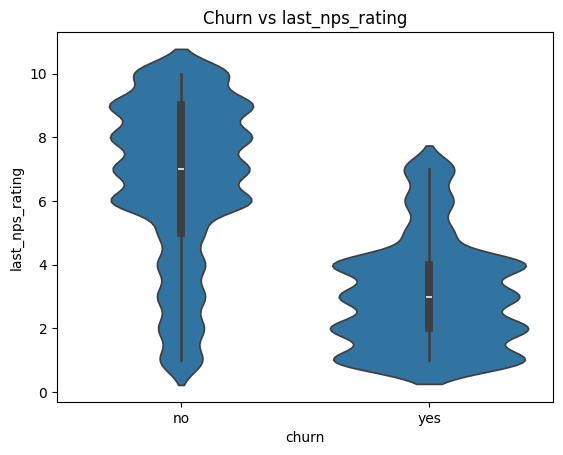

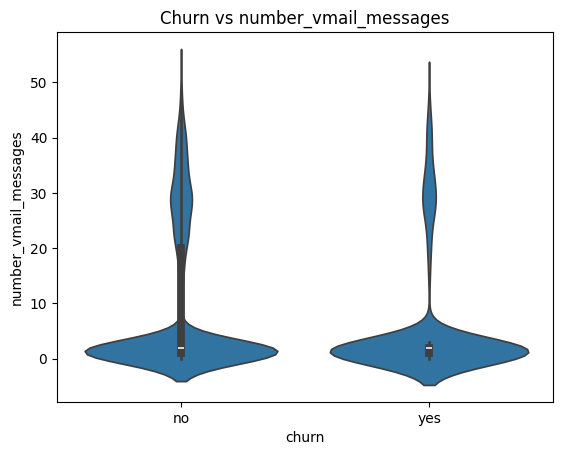

...

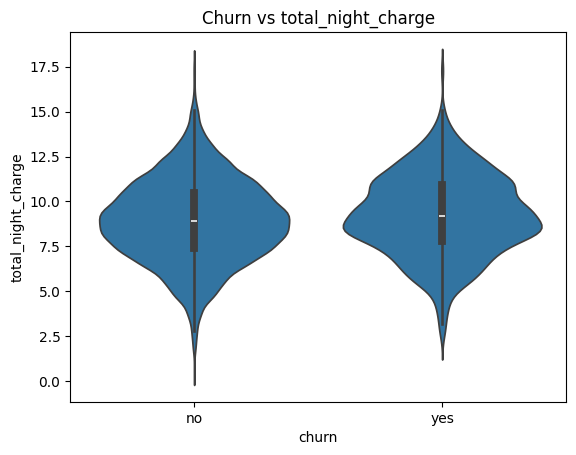

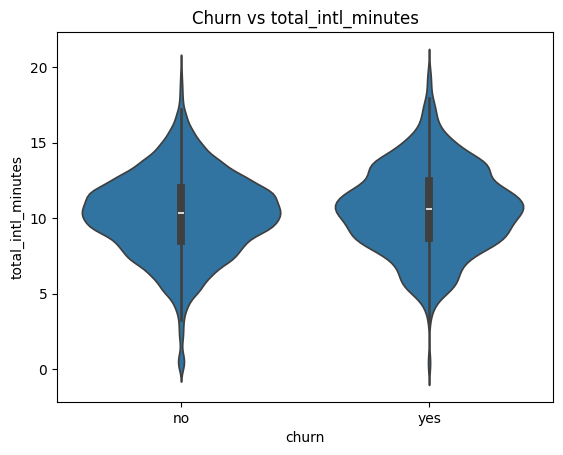

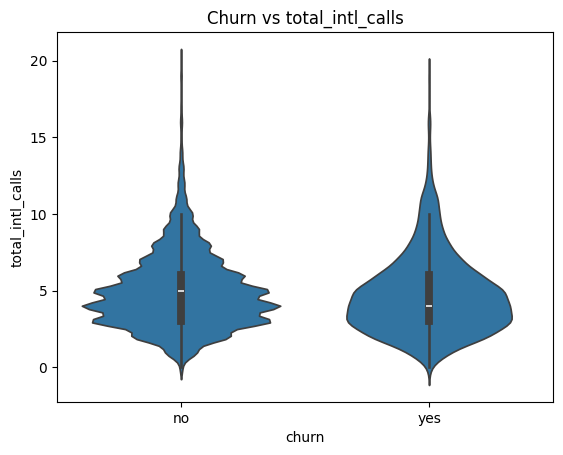

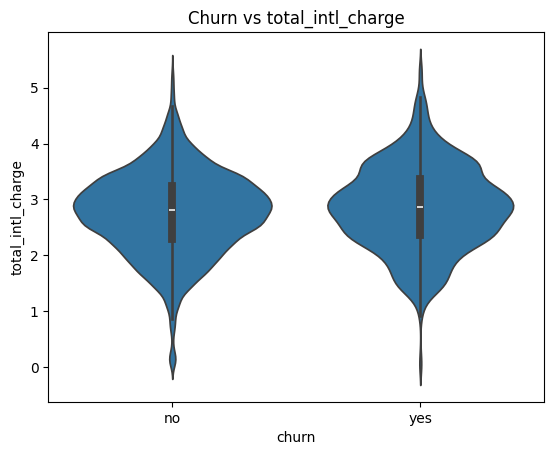

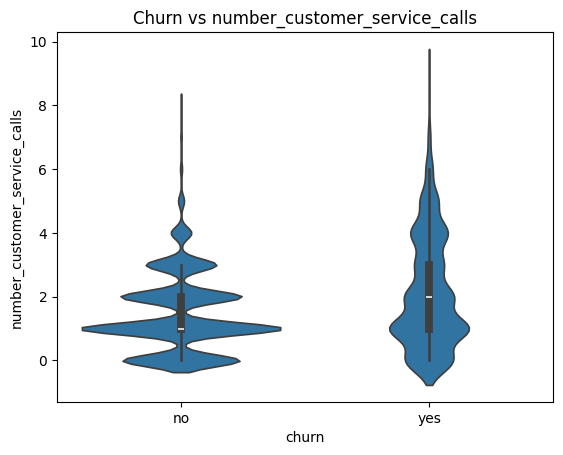

In [70]:
# plot out the distributions against churn 
for col in train.select_dtypes(exclude='object').columns: 
    sns.violinplot(x='churn', y=col, data=train).set_title(f'Churn vs {col}')
    plt.show()

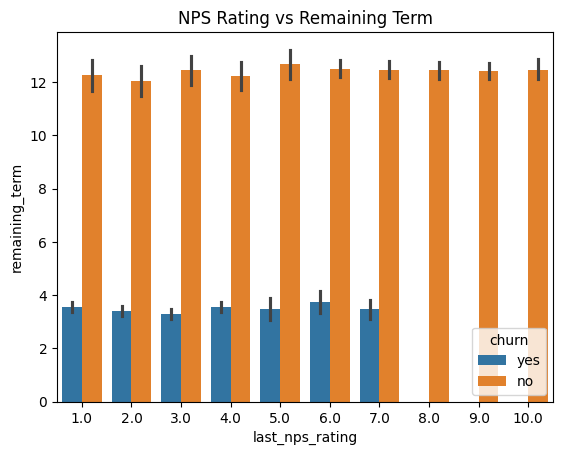

In [71]:
plt.title('NPS Rating vs Remaining Term')
sns.barplot(x='last_nps_rating', y='remaining_term', hue='churn', data=train)
plt.show()

### Check categorical relationships

In [73]:
train.promotions_offered.unique()

array(['No', 'Yes', nan, 'NO'], dtype=object)

Let's fill the proper promotions to see correct views

In [75]:
train['promotions_offered'] = train['promotions_offered'].replace(['NO', np.nan], 'No')

Given the table below we can see that peoople tend to churn more if they are not given a prompotion.
That's the inspections we need to do and check to communicate to the stakeholders. So keep changing the column name to see what do you can deduce.

In [77]:
pivot_feature = 'promotions_offered' 
pd.crosstab(train[pivot_feature], train['churn']) / len(train)

churn,no,yes
promotions_offered,,
No,0.824271,0.115847
Yes,0.032405,0.027476


Now let's inspect all the columns in the bivariate analysis given churn variable.

In [78]:
for col in train.select_dtypes(include='object').columns: 
    if col != 'churn': 
        display(pd.crosstab(train[col], train['churn']) / len(train))

churn,no,yes
state_code,,
AK,0.013702,0.001087
AL,0.019139,0.002900
AR,0.015079,0.002247
AZ,0.016819,0.001667
CA,0.007467,0.001812
CO,0.018704,0.002465
CT,0.017761,0.003770
DC,0.014572,0.002537
DE,0.015731,0.003117


churn,no,yes
promotions_offered,,
No,0.824271,0.115847
Yes,0.032405,0.027476


churn,no,yes
area_code,,
area_code_408,0.215963,0.036393
area_code_415,0.425547,0.068798
area_code_510,0.214369,0.038133


churn,no,yes
international_plan,,
no,0.796796,0.108018
yes,0.059881,0.035305


churn,no,yes
voice_mail_plan,,
no,0.615340,0.121212
yes,0.239814,0.021531


### Relationship between two vars
Namely when Remaining term < 5 and Last nps rating < 7

In [79]:
train[['remaining_term']].head()

,remaining_term
id,
4115,10.0
5910,8.0
8136,17.0
15227,3.0
16632,22.0


In [72]:
train['nps_less_7'] = (train['last_nps_rating'] <= 7).astype(int)
train['remaining_term_less_5'] = (train['remaining_term'] < 5).astype(int)
train['churn_yes'] = train['churn'].apply(lambda x: 1 if x=='yes' else 0)
train['churn_no'] = train['churn'].apply(lambda x: 0 if x=='yes' else 1)

In [73]:
train.groupby(['nps_less_7','remaining_term_less_5']).sum(['churn_yes', 'churn_no'])[['churn_yes','churn_no']] / len(train)

churn_yes  churn_no
nps_less_7 remaining_term_less_5                     
0          0                       0.000000  0.305220
           1                       0.000000  0.061392
1          0                       0.043331  0.405468
           1                       0.099751  0.084838

In [74]:
train.groupby(['nps_less_7','remaining_term_less_5', 'promotions_offered']).sum(['churn_yes', 'churn_no'])[['churn_yes','churn_no']] / len(train)

churn_yes  churn_no
nps_less_7 remaining_term_less_5 promotions_offered                     
0          0                     No                   0.000000  0.305220
           1                     No                   0.000000  0.061392
1          0                     No                   0.035543  0.405468
                                 Yes                  0.007788  0.000000
           1                     No                   0.080116  0.052361
                                 Yes                  0.019635  0.032477

In [76]:
train.drop(['nps_less_7', 'remaining_term_less_5','churn_yes','churn_no'], axis=1, inplace=True)

In [77]:
train.columns

Index(['state_code', 'tenure', 'contract_length', 'promotions_offered',
       'remaining_term', 'last_nps_rating', 'area_code', 'international_plan',
       'voice_mail_plan', 'number_vmail_messages', 'total_day_minutes',
       'total_day_calls', 'total_day_charge', 'total_eve_minutes',
       'total_eve_calls', 'total_eve_charge', 'total_night_minutes',
       'total_night_calls', 'total_night_charge', 'total_intl_minutes',
       'total_intl_calls', 'total_intl_charge',
       'number_customer_service_calls', 'churn'],
      dtype='object')

Data Preprocessing

## Double check we're operating with a clean slate

In [79]:
train.columns

Index(['state_code', 'tenure', 'contract_length', 'promotions_offered',
       'remaining_term', 'last_nps_rating', 'area_code', 'international_plan',
       'voice_mail_plan', 'number_vmail_messages', 'total_day_minutes',
       'total_day_calls', 'total_day_charge', 'total_eve_minutes',
       'total_eve_calls', 'total_eve_charge', 'total_night_minutes',
       'total_night_calls', 'total_night_charge', 'total_intl_minutes',
       'total_intl_calls', 'total_intl_charge',
       'number_customer_service_calls', 'churn'],
      dtype='object')

In [81]:
df.columns

Index(['state_code', 'tenure', 'contract_length', 'promotions_offered',
       'remaining_term', 'last_nps_rating', 'area_code', 'international_plan',
       'voice_mail_plan', 'number_vmail_messages', 'total_day_minutes',
       'total_day_calls', 'total_day_charge', 'total_eve_minutes',
       'total_eve_calls', 'total_eve_charge', 'total_night_minutes',
       'total_night_calls', 'total_night_charge', 'total_intl_minutes',
       'total_intl_calls', 'total_intl_charge',
       'number_customer_service_calls', 'churn'],
      dtype='object')

In [78]:
[col in df.columns for col in train.columns]

[True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True]

## Missing Area Code Data - Categorical

In [86]:
train[train['area_code'].isnull()].head()

,state_code,tenure,contract_length,promotions_offered,remaining_term,last_nps_rating,area_code,international_plan,voice_mail_plan,number_vmail_messages,...,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls,churn
id,,,,,,,,,,,,,,,,,,,,,
17168,WY,54,18.0,No,19.0,7.0,NaN,no,NaN,40,...,111,16.548064,193.086752,114,8.808353,9.344790,4,2.634894,0,no
4558,WY,58,22.0,No,20.0,6.0,NaN,no,NaN,41,...,111,15.370818,185.992442,115,8.634951,9.258257,4,2.522559,0,no
13336,RI,79,13.0,No,9.0,6.0,NaN,no,no,2,...,68,14.943610,162.052384,106,7.171747,13.576263,6,3.658442,1,no
5772,MO,155,12.0,No,3.0,9.0,NaN,yes,no,0,...,98,8.018185,200.103367,96,9.318969,7.688405,7,1.940647,0,no
1642,MO,154,15.0,No,2.0,7.0,NaN,yes,no,1,...,100,8.753738,198.839157,94,9.278937,7.073209,6,1.943637,0,no


In [87]:
train['area_code'] = train['area_code'].fillna('missing')
train[train['area_code']=='missing']

,state_code,tenure,contract_length,promotions_offered,remaining_term,last_nps_rating,area_code,international_plan,voice_mail_plan,number_vmail_messages,...,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls,churn
id,,,,,,,,,,,,,,,,,,,,,
17168,WY,54,18.0,No,19.0,7.0,missing,no,NaN,40,...,111,16.548064,193.086752,114,8.808353,9.344790,4,2.634894,0,no
4558,WY,58,22.0,No,20.0,6.0,missing,no,NaN,41,...,111,15.370818,185.992442,115,8.634951,9.258257,4,2.522559,0,no
13336,RI,79,13.0,No,9.0,6.0,missing,no,no,2,...,68,14.943610,162.052384,106,7.171747,13.576263,6,3.658442,1,no
5772,MO,155,12.0,No,3.0,9.0,missing,yes,no,0,...,98,8.018185,200.103367,96,9.318969,7.688405,7,1.940647,0,no
1642,MO,154,15.0,No,2.0,7.0,missing,yes,no,1,...,100,8.753738,198.839157,94,9.278937,7.073209,6,1.943637,0,no
16450,FL,147,16.0,No,9.0,8.0,missing,yes,no,1,...,93,20.838636,187.249514,66,8.307897,8.289207,5,2.255682,2,no
12972,MO,153,24.0,No,13.0,6.0,missing,yes,no,0,...,98,8.515226,207.015705,92,9.090795,7.466579,6,2.008288,0,no


In [88]:
train.isnull().sum()

state_code                        0
tenure                            0
contract_length                  29
promotions_offered                0
remaining_term                   29
last_nps_rating                  29
area_code                         0
international_plan                0
voice_mail_plan                  20
number_vmail_messages             0
total_day_minutes                 0
total_day_calls                   0
total_day_charge                  0
total_eve_minutes                12
total_eve_calls                   0
total_eve_charge                  0
total_night_minutes               0
total_night_calls                 0
total_night_charge                0
total_intl_minutes                0
total_intl_calls                  0
total_intl_charge                 0
number_customer_service_calls     0
churn                            29
dtype: int64

## Missing Voice Mail Plan - Categorical

In [90]:
train.dtypes

state_code                        object
tenure                             int64
contract_length                  float64
promotions_offered                object
remaining_term                   float64
last_nps_rating                  float64
area_code                         object
international_plan                object
voice_mail_plan                   object
number_vmail_messages              int64
total_day_minutes                float64
total_day_calls                    int64
total_day_charge                 float64
total_eve_minutes                float64
total_eve_calls                    int64
total_eve_charge                 float64
total_night_minutes              float64
total_night_calls                  int64
total_night_charge               float64
total_intl_minutes               float64
total_intl_calls                   int64
total_intl_charge                float64
number_customer_service_calls      int64
churn                             object
dtype: object

In [91]:
train['voice_mail_plan'] = train['voice_mail_plan'].fillna('missing')
train[train['voice_mail_plan']=='missing']

,state_code,tenure,contract_length,promotions_offered,remaining_term,last_nps_rating,area_code,international_plan,voice_mail_plan,number_vmail_messages,...,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls,churn
id,,,,,,,,,,,,,,,,,,,,,
16429,HI,44,21.0,No,20.0,10.0,area_code_510,no,missing,1,...,102,18.016167,187.208784,90,8.690546,11.481874,2,3.017702,1,no
10372,HI,42,8.0,No,7.0,6.0,area_code_510,no,missing,2,...,106,17.749234,185.584080,92,8.224325,11.041335,2,3.105547,1,no
11974,MO,15,14.0,No,17.0,9.0,area_code_510,no,missing,1,...,69,11.871465,145.341081,102,7.051341,8.259750,9,2.296696,1,no
3365,MO,18,22.0,No,12.0,2.0,area_code_415,no,missing,2,...,77,22.896967,178.095650,103,8.785522,6.028258,6,1.874301,0,no
17168,WY,54,18.0,No,19.0,7.0,missing,no,missing,40,...,111,16.548064,193.086752,114,8.808353,9.344790,4,2.634894,0,no
7767,AZ,4,9.0,No,7.0,3.0,area_code_408,no,missing,0,...,119,21.481234,281.874501,91,12.695069,11.408316,4,3.225750,1,yes
16037,AZ,6,16.0,No,3.0,2.0,area_code_408,no,missing,2,...,122,22.108010,288.967333,88,13.270796,11.430051,3,3.059472,1,yes
4558,WY,58,22.0,No,20.0,6.0,missing,no,missing,41,...,111,15.370818,185.992442,115,8.634951,9.258257,4,2.522559,0,no
8645,MT,60,17.0,Yes,1.0,4.0,area_code_415,no,missing,1,...,75,19.991544,180.150988,108,8.345667,9.549767,3,2.468519,1,yes


## Missing Evening Minutes - Numeric

In [95]:
train[train['total_eve_minutes'].isnull()][['total_eve_minutes','churn']]

,total_eve_minutes,churn
id,,
16142,NaN,no
17168,NaN,no
4558,NaN,no
11193,NaN,yes
15828,NaN,no
12703,NaN,yes
2729,NaN,no
11475,NaN,no
15905,NaN,no


In [100]:
mean_eve_mins = train['total_eve_minutes'].mean().round(2)
mean_eve_mins

200.29

In [98]:
train['total_day_charge'].std()

9.301167660651814

In [101]:
train['total_eve_minutes_missing'] = train['total_eve_minutes'].isnull().astype(int)
train['total_eve_minutes'] = train['total_eve_minutes'].fillna(mean_eve_mins)

In [104]:
train[train['total_eve_minutes_missing']==1][['total_eve_minutes_missing','total_eve_minutes']]

,total_eve_minutes_missing,total_eve_minutes
id,,
16142,1,200.29
17168,1,200.29
4558,1,200.29
11193,1,200.29
15828,1,200.29
12703,1,200.29
2729,1,200.29
11475,1,200.29
15905,1,200.29


## Missing Target Variables

In [105]:
train.isnull().sum()

state_code                        0
tenure                            0
contract_length                  29
promotions_offered                0
remaining_term                   29
last_nps_rating                  29
area_code                         0
international_plan                0
voice_mail_plan                   0
number_vmail_messages             0
total_day_minutes                 0
total_day_calls                   0
total_day_charge                  0
total_eve_minutes                 0
total_eve_calls                   0
total_eve_charge                  0
total_night_minutes               0
total_night_calls                 0
total_night_charge                0
total_intl_minutes                0
total_intl_calls                  0
total_intl_charge                 0
number_customer_service_calls     0
churn                            29
total_eve_minutes_missing         0
dtype: int64

In [118]:
train[train['churn'].isnull()]

,state_code,tenure,contract_length,promotions_offered,remaining_term,last_nps_rating,area_code,international_plan,voice_mail_plan,number_vmail_messages,...,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls,churn,total_eve_minutes_missing
id,,,,,,,,,,,,,,,,,,,,,


In [117]:
train = train[~train['churn'].isnull()]
train.isnull().sum()

state_code                       0
tenure                           0
contract_length                  0
promotions_offered               0
remaining_term                   0
last_nps_rating                  0
area_code                        0
international_plan               0
voice_mail_plan                  0
number_vmail_messages            0
total_day_minutes                0
total_day_calls                  0
total_day_charge                 0
total_eve_minutes                0
total_eve_calls                  0
total_eve_charge                 0
total_night_minutes              0
total_night_calls                0
total_night_charge               0
total_intl_minutes               0
total_intl_calls                 0
total_intl_charge                0
number_customer_service_calls    0
churn                            0
total_eve_minutes_missing        0
dtype: int64

# Feature Engineering

## Ratio for Correlated Predictor Variables

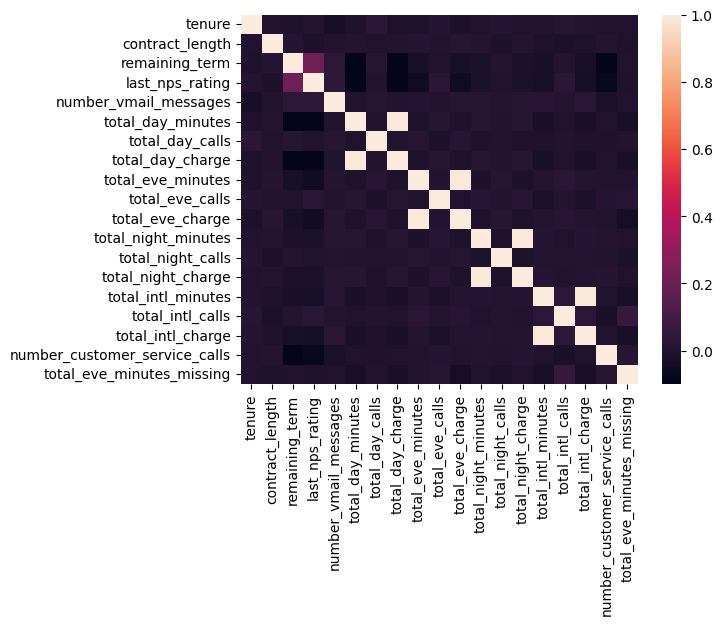

In [119]:
sns.heatmap(train.select_dtypes(exclude='object').corr())
plt.show() 

In [120]:
# Create ratios
train['day_ratio'] = train['total_day_charge'] / train['total_day_minutes']
train['eve_ratio'] = train['total_eve_charge'] / train['total_eve_minutes']
train['night_ratio'] = train['total_night_charge'] / train['total_night_minutes']
train['intl_ratio'] = train['total_intl_charge'] / train['total_intl_minutes']

C:\Users\User\AppData\Local\Temp\ipykernel_14724\1293876516.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train['day_ratio'] = train['total_day_charge'] / train['total_day_minutes']
C:\Users\User\AppData\Local\Temp\ipykernel_14724\1293876516.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train['eve_ratio'] = train['total_eve_charge'] / train['total_eve_minutes']
C:\Users\User\AppData\Local\Temp\ipykernel_14724\1293876516.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a sl

In [121]:
train.head()

,state_code,tenure,contract_length,promotions_offered,remaining_term,last_nps_rating,area_code,international_plan,voice_mail_plan,number_vmail_messages,...,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls,churn,total_eve_minutes_missing,day_ratio,eve_ratio,night_ratio,intl_ratio
id,,,,,,,,,,,,,,,,,,,,,
16692,TN,100,18.0,No,23.0,9.0,area_code_510,no,no,2,...,8.308312,9,2.208759,2,no,0,0.172815,0.083632,0.043008,0.265849
6970,DE,92,15.0,No,7.0,7.0,area_code_510,no,no,0,...,8.238645,2,2.168779,1,yes,0,0.169215,0.084485,0.045763,0.263245
9747,AZ,62,10.0,No,18.0,10.0,area_code_415,no,yes,20,...,11.084169,5,3.153671,0,no,0,0.158396,0.088938,0.046510,0.284520
16099,KY,143,12.0,No,12.0,6.0,area_code_408,no,no,1,...,19.981388,4,5.242569,0,no,0,0.178475,0.086951,0.043587,0.262373
8833,HI,123,19.0,No,23.0,7.0,area_code_510,no,no,0,...,11.670808,9,3.205746,2,no,0,0.168656,0.081817,0.043780,0.274681


In [122]:
train = train.drop(['total_day_charge','total_eve_charge','total_night_charge','total_intl_charge','total_day_minutes','total_eve_minutes','total_night_minutes', 'total_intl_minutes'], axis=1)

In [124]:
train.columns

Index(['state_code', 'tenure', 'contract_length', 'promotions_offered',
       'remaining_term', 'last_nps_rating', 'area_code', 'international_plan',
       'voice_mail_plan', 'number_vmail_messages', 'total_day_calls',
       'total_eve_calls', 'total_night_calls', 'total_intl_calls',
       'number_customer_service_calls', 'churn', 'total_eve_minutes_missing',
       'day_ratio', 'eve_ratio', 'night_ratio', 'intl_ratio'],
      dtype='object')

## Variable Skewness

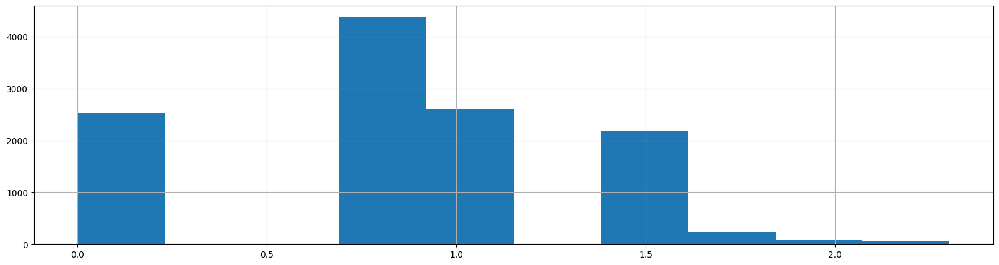

In [125]:
train['number_customer_service_calls'] = np.log(train['number_customer_service_calls']+1)
train['number_customer_service_calls'].hist(figsize=(20,5))
plt.show()

## Feature Engineering Of Customers

In [126]:
train['promotions_offered'] = train['promotions_offered'].replace(['NO', np.NaN], 'No')

In [127]:
train.isnull().sum()

state_code                       0
tenure                           0
contract_length                  0
promotions_offered               0
remaining_term                   0
last_nps_rating                  0
area_code                        0
international_plan               0
voice_mail_plan                  0
number_vmail_messages            0
total_day_calls                  0
total_eve_calls                  0
total_night_calls                0
total_intl_calls                 0
number_customer_service_calls    0
churn                            0
total_eve_minutes_missing        0
day_ratio                        0
eve_ratio                        0
night_ratio                      0
intl_ratio                       0
dtype: int64

In [139]:
train['unhappy_customers'] = ((train.remaining_term < 5) 
                              & (train.last_nps_rating <=7) 
                              & (train.promotions_offered == 'No')).astype(int)

In [142]:
train[train['unhappy_customers']==1].head()

,state_code,tenure,contract_length,promotions_offered,remaining_term,last_nps_rating,area_code,international_plan,voice_mail_plan,number_vmail_messages,...,total_night_calls,total_intl_calls,number_customer_service_calls,churn,total_eve_minutes_missing,day_ratio,eve_ratio,night_ratio,intl_ratio,unhappy_customers
id,,,,,,,,,,,,,,,,,,,,,
3584,NM,182,10.0,No,3.0,3.0,area_code_408,no,yes,30,...,118,1,1.386294,no,0,0.169449,0.087521,0.045246,0.274974,1
17212,OK,103,23.0,No,4.0,2.0,area_code_415,no,no,2,...,89,16,0.693147,yes,0,0.169476,0.084495,0.045747,0.258265,1
2321,MT,100,22.0,No,2.0,7.0,area_code_415,no,no,1,...,81,4,0.693147,no,0,0.171099,0.083300,0.044048,0.267411,1
15834,WA,58,23.0,No,2.0,3.0,area_code_408,no,no,1,...,142,8,0.000000,yes,0,0.171940,0.089352,0.047560,0.274232,1
8608,IN,67,9.0,No,2.0,4.0,area_code_510,no,no,2,...,99,6,1.098612,yes,0,0.175524,0.084723,0.043051,0.246410,1


## Create Target and Feature Variables

In [144]:
from sklearn.preprocessing import OneHotEncoder

In [150]:
# Create X and y variables
X_train = train.drop('churn', axis=1)
y_train = np.where(train['churn']=='yes', 1, 0)

In [151]:
# Validating churn is dropped
'churn' in list(X_train.columns)

False

In [152]:
# Check y value
y_train

array([0, 1, 0, ..., 0, 0, 0])

In [153]:
# Create the one hot encoder
onehot = OneHotEncoder(handle_unknown='ignore')
# Apply one hot encoding to categorical columns 
encoded_columns = onehot.fit_transform(X_train.select_dtypes(include='object')).toarray()

In [154]:
encoded_columns

array([[0., 0., 0., ..., 0., 1., 0.],
       [0., 0., 0., ..., 0., 1., 0.],
       [0., 0., 0., ..., 0., 0., 1.],
       ...,
       [0., 0., 0., ..., 0., 1., 0.],
       [0., 0., 0., ..., 0., 1., 0.],
       [0., 0., 0., ..., 0., 1., 0.]])

In [156]:
onehot.get_feature_names_out()

array(['state_code_AK', 'state_code_AL', 'state_code_AR', 'state_code_AZ',
       'state_code_CA', 'state_code_CO', 'state_code_CT', 'state_code_DC',
       'state_code_DE', 'state_code_FL', 'state_code_GA', 'state_code_HI',
       'state_code_IA', 'state_code_ID', 'state_code_IL', 'state_code_IN',
       'state_code_KS', 'state_code_KY', 'state_code_LA', 'state_code_MA',
       'state_code_MD', 'state_code_ME', 'state_code_MI', 'state_code_MN',
       'state_code_MO', 'state_code_MS', 'state_code_MT', 'state_code_NC',
       'state_code_ND', 'state_code_NE', 'state_code_NH', 'state_code_NJ',
       'state_code_NM', 'state_code_NV', 'state_code_NY', 'state_code_OH',
       'state_code_OK', 'state_code_OR', 'state_code_PA', 'state_code_RI',
       'state_code_SC', 'state_code_SD', 'state_code_TN', 'state_code_TX',
       'state_code_UT', 'state_code_VA', 'state_code_VT', 'state_code_WA',
       'state_code_WI', 'state_code_WV', 'state_code_WY',
       'promotions_offered_No', 'promotion

In [157]:
X_train = X_train.select_dtypes(exclude='object')
X_train[onehot.get_feature_names_out()] = encoded_columns

In [159]:
X_train.columns

Index(['tenure', 'contract_length', 'remaining_term', 'last_nps_rating',
       'number_vmail_messages', 'total_day_calls', 'total_eve_calls',
       'total_night_calls', 'total_intl_calls',
       'number_customer_service_calls', 'total_eve_minutes_missing',
       'day_ratio', 'eve_ratio', 'night_ratio', 'intl_ratio',
       'unhappy_customers', 'state_code_AK', 'state_code_AL', 'state_code_AR',
       'state_code_AZ', 'state_code_CA', 'state_code_CO', 'state_code_CT',
       'state_code_DC', 'state_code_DE', 'state_code_FL', 'state_code_GA',
       'state_code_HI', 'state_code_IA', 'state_code_ID', 'state_code_IL',
       'state_code_IN', 'state_code_KS', 'state_code_KY', 'state_code_LA',
       'state_code_MA', 'state_code_MD', 'state_code_ME', 'state_code_MI',
       'state_code_MN', 'state_code_MO', 'state_code_MS', 'state_code_MT',
       'state_code_NC', 'state_code_ND', 'state_code_NE', 'state_code_NH',
       'state_code_NJ', 'state_code_NM', 'state_code_NV', 'state_code_NY',

## Dealing with Imbalance

In [161]:
!pip install imbalanced-learn

You should consider upgrading via the 'D:\Full Stack Machine Learning\fullstack\Scripts\python.exe -m pip install --upgrade pip' command.


In [163]:
from imblearn.under_sampling import RandomUnderSampler
from imblearn.over_sampling import SMOTE, RandomOverSampler

In [172]:
# Create the SMOTE class
sm = SMOTE(random_state=1234)
# Resample to balance the dataset
X_train, y_train = sm.fit_resample(X_train, y_train)

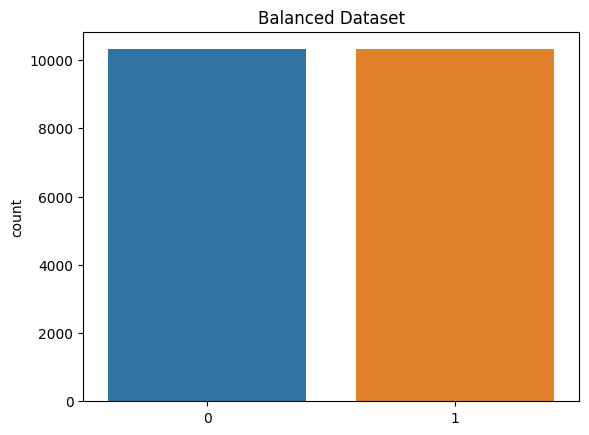

In [173]:
sns.countplot(x=y_train).set_title('Balanced Dataset')
plt.show()

# Modelling

## Pipeline

In [176]:
# Import pipeline dependencies
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler

In [177]:
# Import algorithms
from sklearn.linear_model import SGDClassifier, RidgeClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from xgboost import XGBClassifier

In [178]:
pipelines = {
    'sgd':make_pipeline(StandardScaler(), SGDClassifier()), 
    'ridge':make_pipeline(StandardScaler(), RidgeClassifier()), 
    'rf':make_pipeline(StandardScaler(), RandomForestClassifier()), 
    'gb':make_pipeline(StandardScaler(), GradientBoostingClassifier()), 
    'xg':make_pipeline(StandardScaler(), XGBClassifier()), 
}

## Grid Search

In [185]:
pipelines['xg'].get_params()

{'memory': None,
 'steps': [('standardscaler', StandardScaler()),
  ('xgbclassifier',
   XGBClassifier(base_score=None, booster=None, callbacks=None,
                 colsample_bylevel=None, colsample_bynode=None,
                 colsample_bytree=None, early_stopping_rounds=None,
                 enable_categorical=False, eval_metric=None, feature_types=None,
                 gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
                 interaction_constraints=None, learning_rate=None, max_bin=None,
                 max_cat_threshold=None, max_cat_to_onehot=None,
                 max_delta_step=None, max_depth=None, max_leaves=None,
                 min_child_weight=None, missing=nan, monotone_constraints=None,
                 n_estimators=100, n_jobs=None, num_parallel_tree=None,
                 predictor=None, random_state=None, ...))],
 'verbose': False,
 'standardscaler': StandardScaler(),
 'xgbclassifier': XGBClassifier(base_score=None, booster=None, callbac

In [188]:
grid = {
    'sgd':{
        'sgdclassifier__alpha':[0.00001, 0.0001, 0.001, 0.01]
    },
    'ridge':{
        'ridgeclassifier__alpha':[0.01, 0.5, 1.0, 2.0, 3.0]
    },
    'rf':{
        'randomforestclassifier__n_estimators':[50,100,200,300], 
        'randomforestclassifier__max_depth':[None, 5, 7, 9]
    },
    'gb':{
        'gradientboostingclassifier__n_estimators':[50,100,200,300], 
        'gradientboostingclassifier__max_depth':[None, 3, 5, 7, 9]
    },
    'xg':{
        'xgbclassifier__n_estimators':[50,100,200,300], 
        'xgbclassifier__max_depth':[None, 3, 5, 7, 9]
    }
}

## Training

In [189]:
from sklearn.model_selection import GridSearchCV

In [190]:
fit_models = {}
for algo, pipeline in pipelines.items(): 
    try: 
        print(f'Commencing training for {algo}')
        # DO training here 
        model = GridSearchCV(pipeline, grid[algo], n_jobs=-1, cv=10)
        model.fit(X_train, y_train)
        fit_models[algo] = model 
        print(f'Training completed for {algo}')

    except Exception as e: 
        print(f'There was an error training the {algo} model: {e}')

Commencing training for sgd
Training completed for sgd
Commencing training for ridge
Training completed for ridge
Commencing training for rf
Training completed for rf
Commencing training for gb
Training completed for gb
Commencing training for xg
Training completed for xg


In [191]:
fit_models

{'sgd': GridSearchCV(cv=10,
              estimator=Pipeline(steps=[('standardscaler', StandardScaler()),
                                        ('sgdclassifier', SGDClassifier())]),
              n_jobs=-1,
              param_grid={'sgdclassifier__alpha': [1e-05, 0.0001, 0.001, 0.01]}),
 'ridge': GridSearchCV(cv=10,
              estimator=Pipeline(steps=[('standardscaler', StandardScaler()),
                                        ('ridgeclassifier', RidgeClassifier())]),
              n_jobs=-1,
              param_grid={'ridgeclassifier__alpha': [0.01, 0.5, 1.0, 2.0, 3.0]}),
 'rf': GridSearchCV(cv=10,
              estimator=Pipeline(steps=[('standardscaler', StandardScaler()),
                                        ('randomforestclassifier',
                                         RandomForestClassifier())]),
              n_jobs=-1,
              param_grid={'randomforestclassifier__max_depth': [None, 5, 7, 9],
                          'randomforestclassifier__n_estimators':

# Evaluation

## Transformations to test the data

In [193]:
col_order = X_train.columns; col_order

Index(['tenure', 'contract_length', 'remaining_term', 'last_nps_rating',
       'number_vmail_messages', 'total_day_calls', 'total_eve_calls',
       'total_night_calls', 'total_intl_calls',
       'number_customer_service_calls', 'total_eve_minutes_missing',
       'day_ratio', 'eve_ratio', 'night_ratio', 'intl_ratio',
       'unhappy_customers', 'state_code_AK', 'state_code_AL', 'state_code_AR',
       'state_code_AZ', 'state_code_CA', 'state_code_CO', 'state_code_CT',
       'state_code_DC', 'state_code_DE', 'state_code_FL', 'state_code_GA',
       'state_code_HI', 'state_code_IA', 'state_code_ID', 'state_code_IL',
       'state_code_IN', 'state_code_KS', 'state_code_KY', 'state_code_LA',
       'state_code_MA', 'state_code_MD', 'state_code_ME', 'state_code_MI',
       'state_code_MN', 'state_code_MO', 'state_code_MS', 'state_code_MT',
       'state_code_NC', 'state_code_ND', 'state_code_NE', 'state_code_NH',
       'state_code_NJ', 'state_code_NM', 'state_code_NV', 'state_code_NY',

In [194]:
def transform_data(test_df, col_order, mean_eve_mins, onehot): 
    # Copy dataframe
    X = test_df.copy()
    
    # DP - Handle Missing Values
    X['area_code'] =  X['area_code'].fillna('missing')
    X['voice_mail_plan'] = X['voice_mail_plan'].fillna('missing')
    X['total_eve_minutes_missing'] = X['total_eve_minutes'].isnull().astype(int)
    X['total_eve_minutes'] = X['total_eve_minutes'].fillna(mean_eve_mins)
    
    # FE - Ratios
    X['day_ratio'] = X['total_day_charge'] / X['total_day_minutes']
    X['eve_ratio'] = X['total_eve_charge'] / X['total_eve_minutes']
    X['night_ratio'] = X['total_night_charge'] / X['total_night_minutes']
    X['intl_ratio'] = X['total_intl_charge'] / X['total_intl_minutes']
    X = X.drop(['total_day_charge','total_eve_charge','total_night_charge','total_intl_charge','total_day_minutes','total_eve_minutes','total_night_minutes', 'total_intl_minutes'], axis=1)
    
    # FE - Log Transform
    X['number_customer_service_calls'] = np.log(X['number_customer_service_calls']+1)
    
    # FE - Unhappy Customers 
    X['promotions_offered'] = X['promotions_offered'].replace(['NO', np.NaN], 'No')
    X['unhappy_customers'] = ((X.remaining_term < 5) 
                              & (X.last_nps_rating <=7) 
                              & (X.promotions_offered == 'No')).astype(int)
    
    # Onehot encoder 
    encoded_columns = onehot.transform(X.select_dtypes(include='object')).toarray()
    X = X.select_dtypes(exclude='object')
    X[onehot.get_feature_names_out()] = encoded_columns
    
    return X[col_order]

In [195]:
test = test[~test['churn'].isnull()]

In [196]:
test.isnull().sum()

state_code                        0
tenure                            0
contract_length                   0
promotions_offered                0
remaining_term                    0
last_nps_rating                   0
area_code                         5
international_plan                0
voice_mail_plan                  10
number_vmail_messages             0
total_day_minutes                 0
total_day_calls                   0
total_day_charge                  0
total_eve_minutes                 6
total_eve_calls                   0
total_eve_charge                  0
total_night_minutes               0
total_night_calls                 0
total_night_charge                0
total_intl_minutes                0
total_intl_calls                  0
total_intl_charge                 0
number_customer_service_calls     0
churn                             0
dtype: int64

In [197]:
X_test = transform_data(test.drop('churn', axis=1), col_order, mean_eve_mins, onehot)

In [203]:
X_test

,tenure,contract_length,remaining_term,last_nps_rating,number_vmail_messages,total_day_calls,total_eve_calls,total_night_calls,total_intl_calls,number_customer_service_calls,...,promotions_offered_Yes,area_code_area_code_408,area_code_area_code_415,area_code_area_code_510,area_code_missing,international_plan_no,international_plan_yes,voice_mail_plan_missing,voice_mail_plan_no,voice_mail_plan_yes
id,,,,,,,,,,,,,,,,,,,,,
15297,75,13.0,3.0,9.0,1,121,63,97,6,1.386294,...,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
7075,150,17.0,5.0,9.0,1,111,78,88,4,0.693147,...,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
3733,87,11.0,6.0,9.0,2,132,95,49,2,0.693147,...,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0
10674,110,9.0,19.0,6.0,1,85,116,90,3,0.693147,...,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
7360,132,23.0,2.0,1.0,0,101,90,93,8,0.693147,...,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1120,44,24.0,9.0,10.0,2,71,104,113,3,1.386294,...,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0
7101,113,22.0,17.0,9.0,1,112,76,97,6,0.693147,...,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
7062,111,22.0,24.0,9.0,16,78,121,105,8,0.693147,...,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0


In [204]:
y_test = np.where(test['churn']=='yes', 1, 0)

In [209]:
y_test[:50]

array([0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       1, 0, 0, 0, 0, 0])

## Performance Evaluation

In [212]:
from sklearn.metrics import accuracy_score, recall_score, precision_score, confusion_matrix

In [215]:
# Loop through the models
for algo, model in fit_models.items(): 
    # Make a predictions
    yhat = model.predict(X_test)
    # Calculating metrics test partion and our predictions
    accuracy = accuracy_score(y_test, yhat)
    precision = precision_score(y_test, yhat)
    recall = recall_score(y_test, yhat) 
    # Print it out 
    print(f'{algo} model scores Accuracy:{accuracy}, Precision:{precision}, Recall:{recall}') 

sgd model scores Accuracy:0.8915615906886518, Precision:0.5765993265993266, Recall:0.9244264507422402
ridge model scores Accuracy:0.8622696411251213, Precision:0.5111430625449317, Recall:0.9595141700404858
rf model scores Accuracy:0.9487875848690591, Precision:0.797752808988764, Recall:0.8623481781376519
gb model scores Accuracy:0.9501454898157129, Precision:0.8192612137203166, Recall:0.8380566801619433
xg model scores Accuracy:0.950921435499515, Precision:0.840782122905028, Recall:0.8124156545209177


- The precision is the ratio tp / (tp + fp) where tp is the number of true positives and fp the number of false positives. The precision is intuitively the ability of the classifier not to label as positive a sample that is negative.
- The recall is the ratio tp / (tp + fn) where tp is the number of true positives and fn the number of false negatives. The recall is intuitively the ability of the classifier to find all the positive samples.

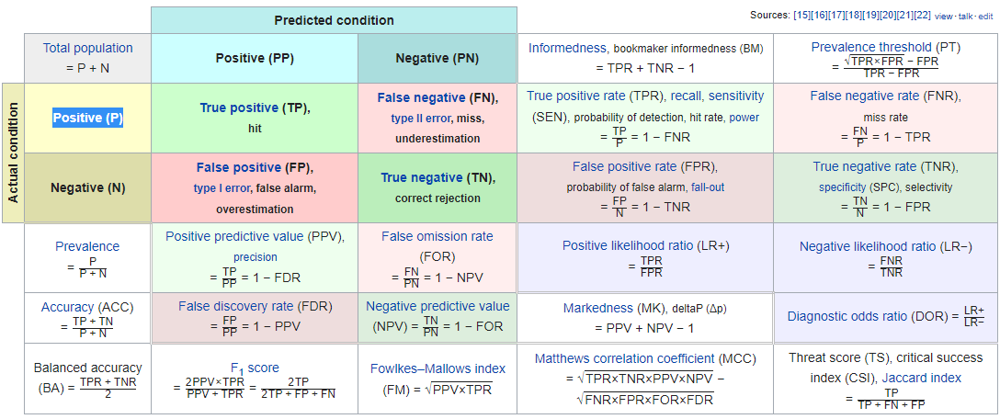

## Performance Metrics of Classification

In [223]:
# xg model scores 
#Accuracy:0.950921435499515, 
#Precision:0.840782122905028, 
#Recall:0.8124156545209177

In [216]:
model = fit_models['xg']

In [217]:
yhat = model.predict(X_test)

In [219]:
yhat[:50]

array([0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       1, 0, 0, 0, 0, 0])

In [220]:
confusion_matrix(y_test, yhat, labels=[1,0])

array([[ 602,  139],
       [ 114, 4300]], dtype=int64)

In [234]:
accuracy = (4300) / ( 602+4300+139+114); accuracy

0.8341416100872939

In [238]:
precision = 602 / (602+114); precision

0.840782122905028

In [239]:
recall = 602 / (602+139); recall

0.8124156545209177

## Make Predictions

In [240]:
yhat = model.predict(X_test); yhat

array([0, 0, 0, ..., 0, 0, 0])

In [251]:
# Create dataframe 
res = pd.DataFrame([y_test, yhat])
res = res.T
res.columns = ['ytrue','ypred']

In [260]:
res.head(6)

,ytrue,ypred
0,0,0
1,0,0
2,0,0
3,0,0
4,1,1
5,1,0


In [259]:
X_test.iloc[5]

tenure                     125.0
contract_length             16.0
remaining_term               7.0
last_nps_rating              2.0
number_vmail_messages       36.0
                           ...  
international_plan_no        1.0
international_plan_yes       0.0
voice_mail_plan_missing      0.0
voice_mail_plan_no           0.0
voice_mail_plan_yes          1.0
Name: 13546, Length: 78, dtype: float64

# Deploy

## Saving the model

In [263]:
import os 
import pickle

In [270]:
# Create file paths 
SAVE_PATH = os.path.join('models', 'experiment_1')
if not os.path.exists(SAVE_PATH):
    os.makedirs(SAVE_PATH)

In [271]:
# Save machine learning models 
for algo, model in fit_models.items(): 
    FILE_PATH = os.path.join(SAVE_PATH, f'{algo}.pkl')
    with open(FILE_PATH, 'wb') as f: 
        pickle.dump(model, f) 

In [274]:
# Save one hot encoder
ENCODER_FILE_PATH = os.path.join(SAVE_PATH, 'encoder.pkl')
with open(ENCODER_FILE_PATH, 'wb') as f: 
    pickle.dump(onehot, f) 

## Create a Schema of the Model

In [276]:
def extract_column_values(col, df): 
    if df[col].dtype == 'O': 
        return list(df[col].unique())
    elif df[col].dtype == 'int64': 
        return (int(df[col].min()), int(df[col].max()))
    elif df[col].dtype == 'float64': 
        return (float(df[col].min()),float(df[col].max()))
    else: 
        return list(df[col].unique().astype(str))

In [281]:
df.select_dtypes(include=int)

,tenure,number_vmail_messages,total_day_calls,total_eve_calls,total_night_calls,total_intl_calls,number_customer_service_calls
id,,,,,,,
0,156,0,63,108,130,7,7
1,216,3,105,71,85,8,3
2,18,1,95,55,127,8,2
3,174,2,53,105,105,4,1
4,68,1,85,88,113,4,0
...,...,...,...,...,...,...,...
17238,142,2,91,125,89,0,3
17239,93,29,85,134,95,6,1
17240,110,2,85,123,59,5,4


In [282]:
extract_column_values('number_vmail_messages', df)

(0, 52)

In [284]:
column_info = {col:{'dtype':str(df[col].dtype), 'values':extract_column_values(col, df)} for col in df.columns}

In [285]:
column_info

{'state_code': {'dtype': 'object',
  'values': ['HI',
   'MI',
   'NH',
   'MN',
   'TX',
   'WY',
   'IN',
   'IL',
   'TN',
   'MA',
   'DC',
   'NV',
   'PA',
   'AK',
   'NM',
   'WI',
   'ND',
   'NJ',
   'AR',
   'NE',
   'NY',
   'OK',
   'SD',
   'KY',
   'ID',
   'VT',
   'IA',
   'MT',
   'AL',
   'MS',
   'ME',
   'WV',
   'RI',
   'VA',
   'OH',
   'SC',
   'MD',
   'CO',
   'AZ',
   'NC',
   'CT',
   'MO',
   'UT',
   'DE',
   'WA',
   'KS',
   'CA',
   'FL',
   'LA',
   'GA',
   'OR']},
 'tenure': {'dtype': 'int64', 'values': (1, 242)},
 'contract_length': {'dtype': 'float64', 'values': (8.0, 24.0)},
 'promotions_offered': {'dtype': 'object', 'values': ['Yes', 'No', 'NO', nan]},
 'remaining_term': {'dtype': 'float64', 'values': (1.0, 24.0)},
 'last_nps_rating': {'dtype': 'float64', 'values': (1.0, 10.0)},
 'area_code': {'dtype': 'object',
  'values': ['area_code_510', 'area_code_408', 'area_code_415', nan]},
 'international_plan': {'dtype': 'object', 'values': ['no', 'yes

In [286]:
transformed_cols = {'transformed_columns':X_train.columns.to_list()}
schema = {'column_info':column_info, 'transformed_columns':transformed_cols}

In [288]:
schema

{'column_info': {'state_code': {'dtype': 'object',
   'values': ['HI',
    'MI',
    'NH',
    'MN',
    'TX',
    'WY',
    'IN',
    'IL',
    'TN',
    'MA',
    'DC',
    'NV',
    'PA',
    'AK',
    'NM',
    'WI',
    'ND',
    'NJ',
    'AR',
    'NE',
    'NY',
    'OK',
    'SD',
    'KY',
    'ID',
    'VT',
    'IA',
    'MT',
    'AL',
    'MS',
    'ME',
    'WV',
    'RI',
    'VA',
    'OH',
    'SC',
    'MD',
    'CO',
    'AZ',
    'NC',
    'CT',
    'MO',
    'UT',
    'DE',
    'WA',
    'KS',
    'CA',
    'FL',
    'LA',
    'GA',
    'OR']},
  'tenure': {'dtype': 'int64', 'values': (1, 242)},
  'contract_length': {'dtype': 'float64', 'values': (8.0, 24.0)},
  'promotions_offered': {'dtype': 'object',
   'values': ['Yes', 'No', 'NO', nan]},
  'remaining_term': {'dtype': 'float64', 'values': (1.0, 24.0)},
  'last_nps_rating': {'dtype': 'float64', 'values': (1.0, 10.0)},
  'area_code': {'dtype': 'object',
   'values': ['area_code_510', 'area_code_408', 'area_code_

In [289]:
os.makedirs('app')

In [290]:
import json
with open(os.path.join('app', 'schema.json'), 'w') as f: 
    json.dump(schema, f) 

# Test Scores

## Load Model and Schema

In [302]:
# Load ML Model
with open(os.path.join(SAVE_PATH, 'xg.pkl'), 'rb') as f:
    model = pickle.load(f)

In [298]:
# Load Encoder
with open(os.path.join(SAVE_PATH, 'encoder.pkl'), 'rb') as f:
    onehot = pickle.load(f)

In [299]:
# Load schema
with open(os.path.join('app', 'schema.json'), 'r') as f:
    schema = json.load(f)

## Transform test sample and predict

In [306]:
res = {
  "state_code": "OH",
  "area_code": "area_code_415",
  "international_plan": "no",
  "voice_mail_plan": "yes",
  "number_vmail_messages": "26",
  "total_day_minutes": 161.6,
  "total_day_calls": 123,
  "total_day_charge": 27.47,
  "total_eve_minutes": 195.5,
  "total_eve_calls": 103,
  "total_eve_charge": 16.62,
  "total_night_minutes": 254.4,
  "total_night_calls": 103,
  "total_night_charge": 11.45,
  "total_intl_minutes": 13.7,
  "total_intl_calls": 3,
  "total_intl_charge": 3.7,
  "promotions_offered":"No", 
  "number_customer_service_calls": 5.0, 
  "tenure":4, 
  "contract_length":5,
  "remaining_term":10, 
  "last_nps_rating":10
}

In [317]:
# Extract column orders
column_order_in = list(schema['column_info'].keys())[:-1]
column_order_out = list(schema['transformed_columns']['transformed_columns'])

In [326]:
# Convert single prediction to a DF
scoring_data = pd.Series(res).to_frame().T
scoring_data = scoring_data[column_order_in]

In [329]:
# Check datatypes
for column, column_properties in schema['column_info'].items(): 
    if column != 'churn': 
        dtype = column_properties['dtype']
        scoring_data[column] = scoring_data[column].astype(dtype)

In [334]:
scoring_sample = transform_data(scoring_data, column_order_out, mean_eve_mins, onehot)

In [336]:
model.predict(scoring_sample)

array([0])

In [337]:
mean_eve_mins

200.29